In [1]:
import numpy as np
import cv2
# multiple cascades: https://github.com/Itseez/opencv/tree/master/data/haarcascades
#https://github.com/Itseez/opencv/blob/master/data/haarcascades/haarcascade_frontalface_default.xml
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

cap = cv2.VideoCapture(0)
while 1:
    ret, img = cap.read()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img[y:y+h, x:x+w]
    cv2.imshow('img',img)
    k = cv2.waitKey(30) & 0xff
    if k == 27:
        break
cap.release()
cv2.destroyAllWindows()


In [4]:
import numpy as np
import cv2
from keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing  import image


model = load_model (r"C:\Users\prince\Documents\mask prediction\mask_prediction.h5")
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_alt2.xml')

cap = cv2.VideoCapture(0)
index=['masked','unmasked']
while 1:
    ret, img = cap.read()
    faces = face_cascade.detectMultiScale(img, scaleFactor=1.1, minNeighbors=3)
   
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi= img[y:y+h, x:x+w]
        roi=cv2.resize(roi,(64,64))
        roi = roi.astype("float")/ 255.0
        roi = cv2.flip(roi,1,1)
        roi = image.img_to_array(roi)
        roi = np.expand_dims(roi, axis=0)
        label=index[np.argmax(model.predict(roi))]
        cv2.putText(img, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 2)

    cv2.imshow('img',img)
    k = cv2.waitKey(30) & 0xff
    if k == 27:
        break
cap.release()
cv2.destroyAllWindows()

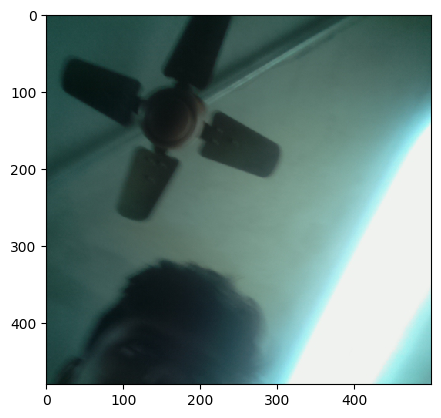

Image is 500x480
Image is verified


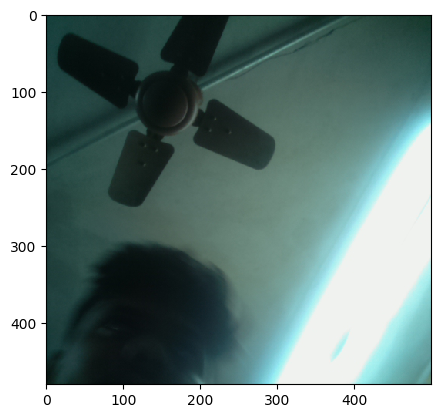

Image is 500x480
Image is verified


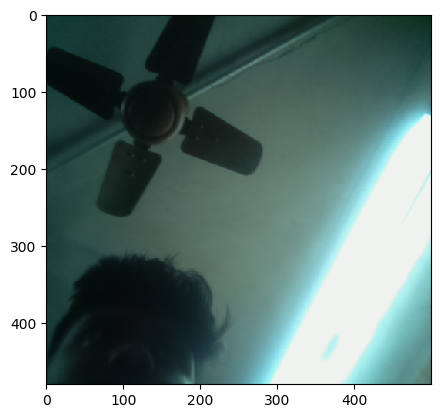

Image is 500x480
Image is verified


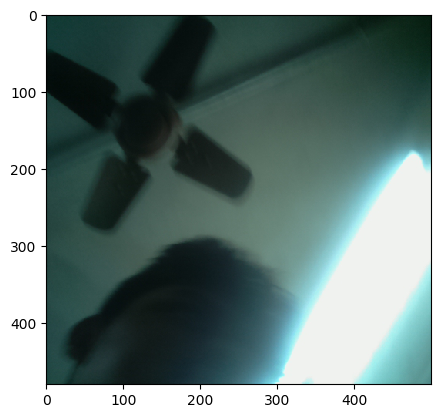

Image is 500x480
Image is verified


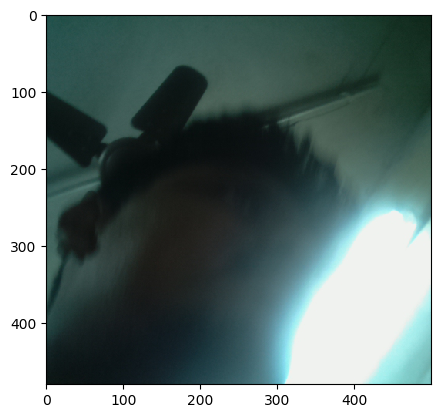

Image is 500x480
Image is verified


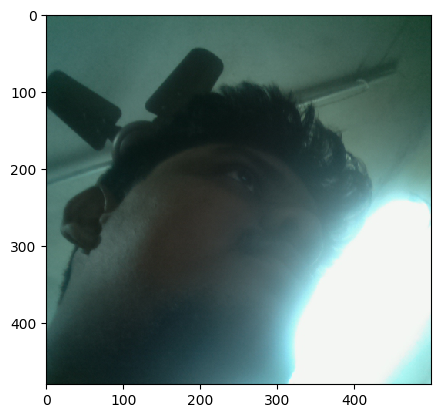

Image is 500x480
Image is verified


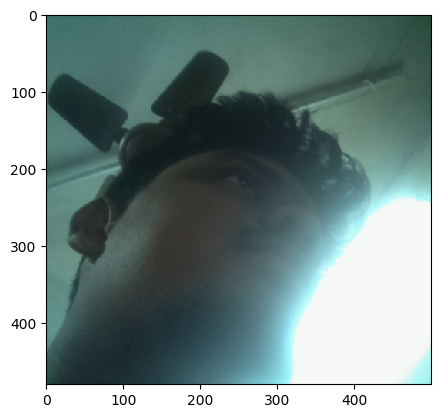

Image is 500x480
Image is verified


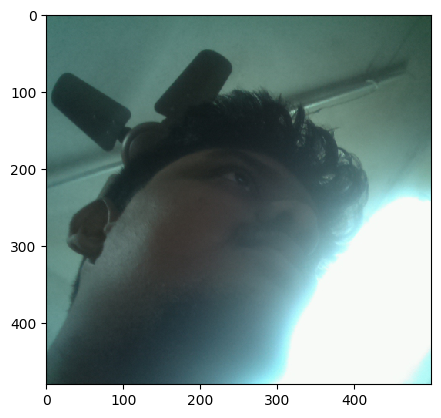

Image is 500x480
Image is verified


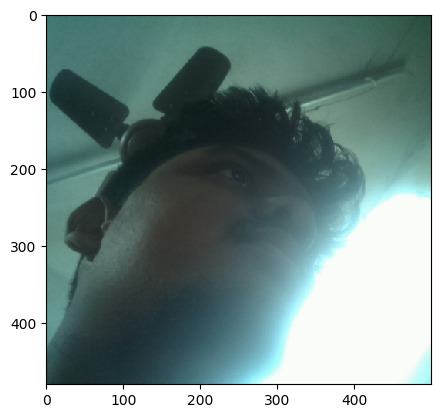

Image is 500x480
Image is verified


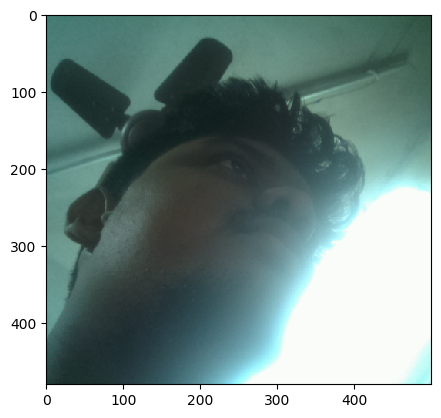

Image is 500x480
Image is verified


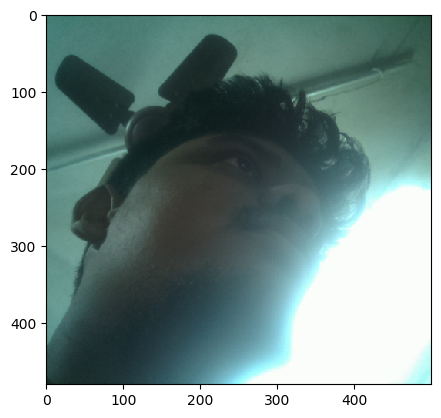

Image is 500x480
Image is verified


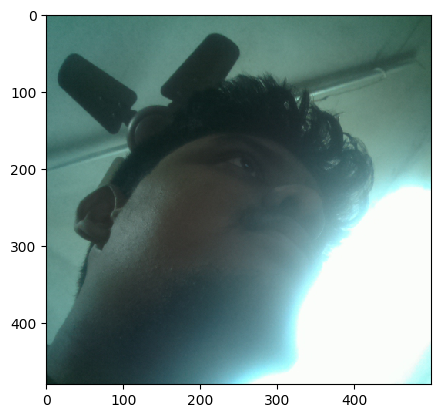

Image is 500x480
Image is verified


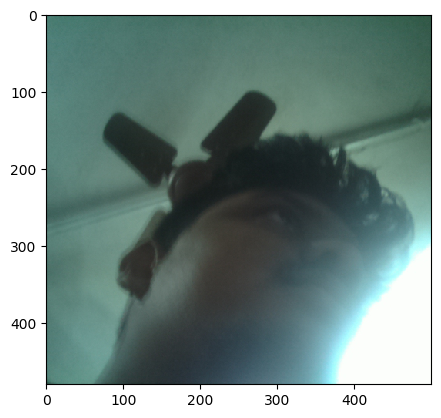

Image is 500x480
Image is verified


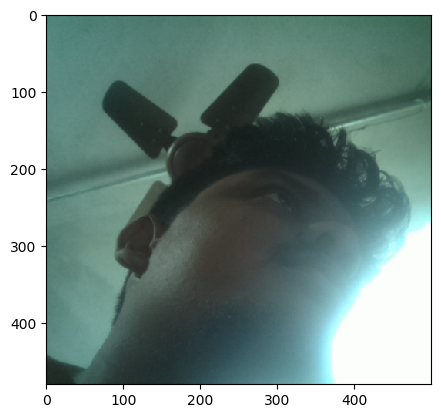

Image is 500x480
Image is verified


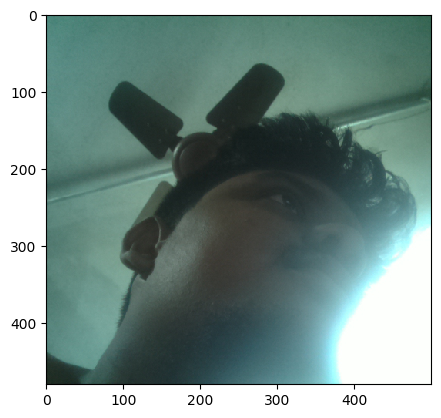

Image is 500x480
Image is verified


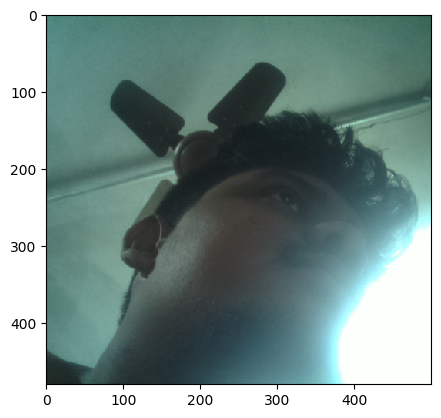

Image is 500x480
Image is verified


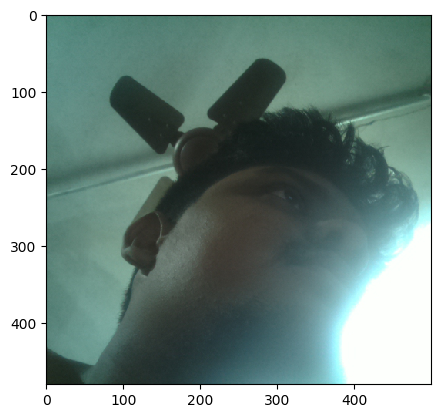

Image is 500x480
Image is verified


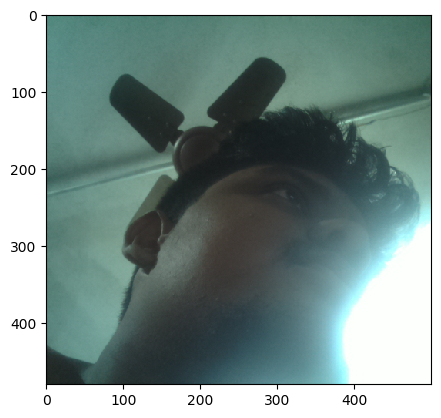

Image is 500x480
Image is verified


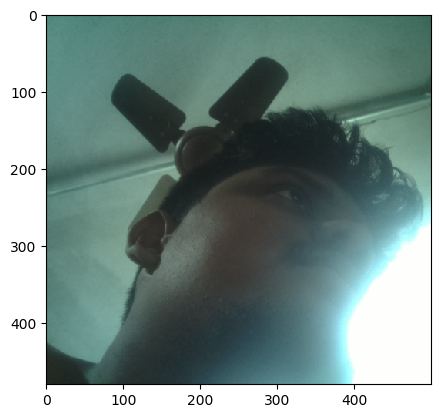

Image is 500x480
Image is verified


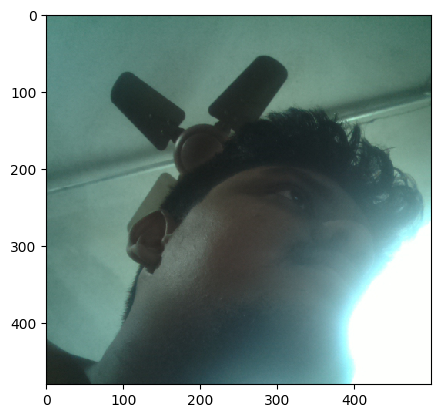

Image is 500x480
Image is verified


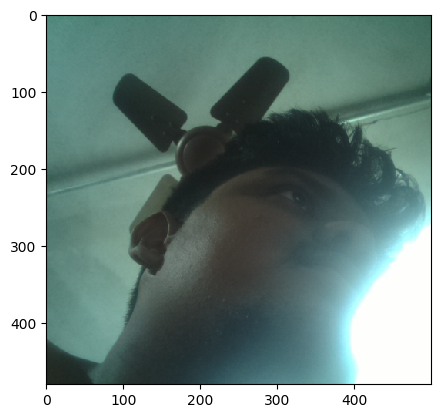

Image is 500x480
Image is verified


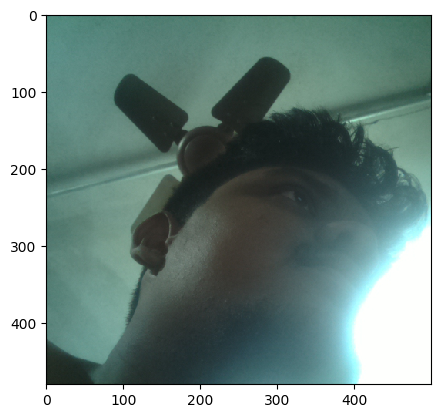

Image is 500x480
Image is verified


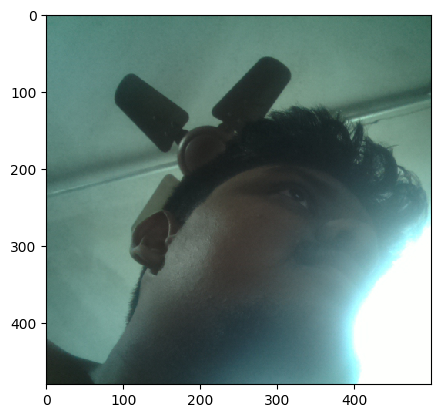

Image is 500x480
Image is verified


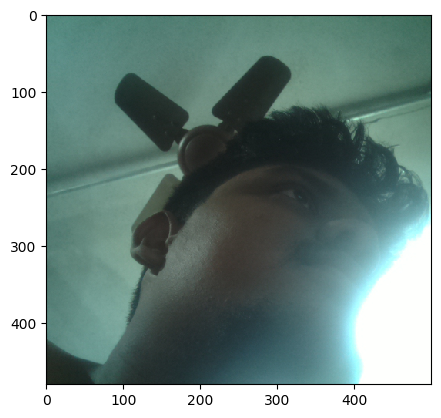

Image is 500x480
Image is verified


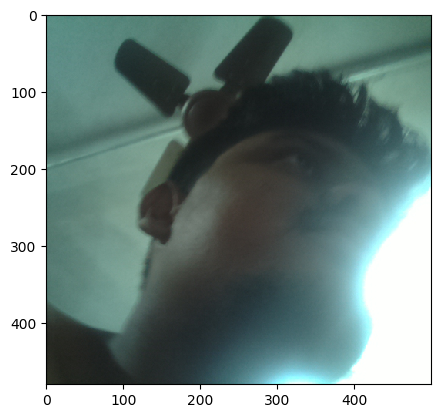

Image is 500x480
Image is verified


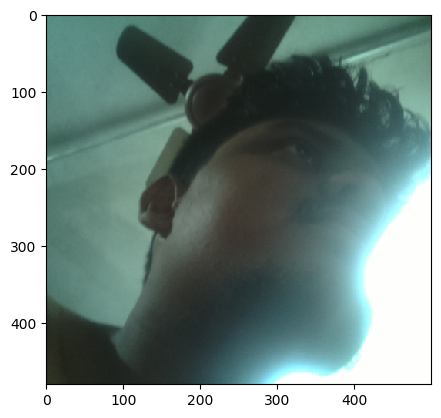

Image is 500x480
Image is verified


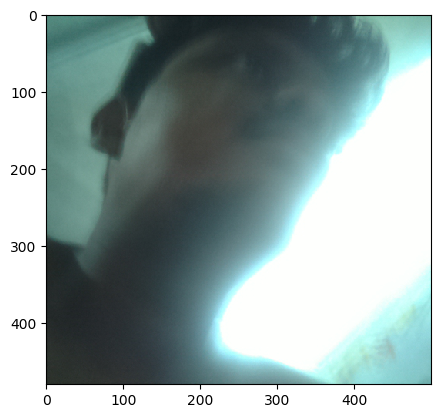

Image is 500x480
Image is verified


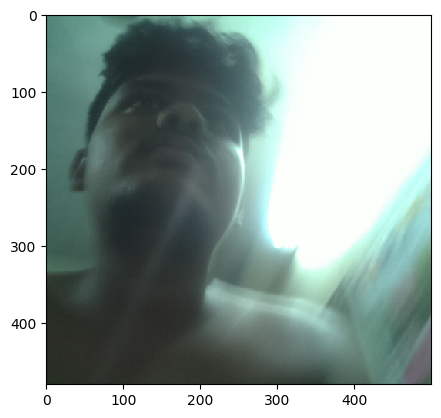

Image is 500x480
Image is verified


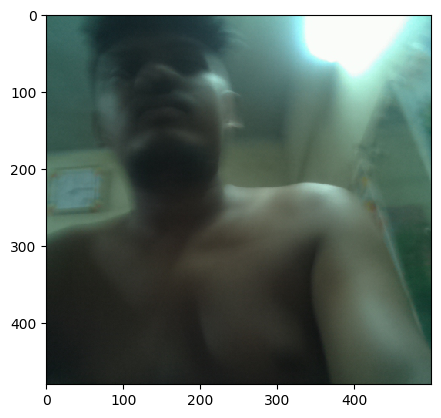

Image is 500x480
Image is verified


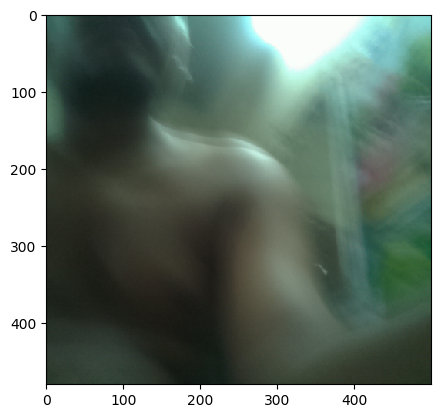

Image is 500x480
Image is verified


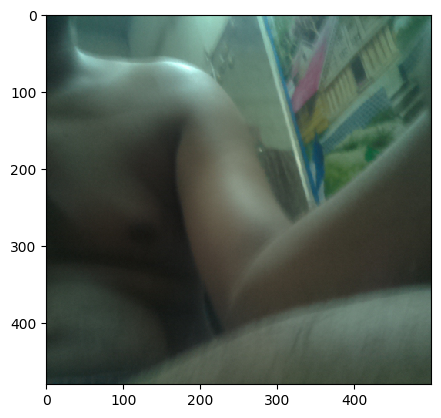

Image is 500x480
Image is verified


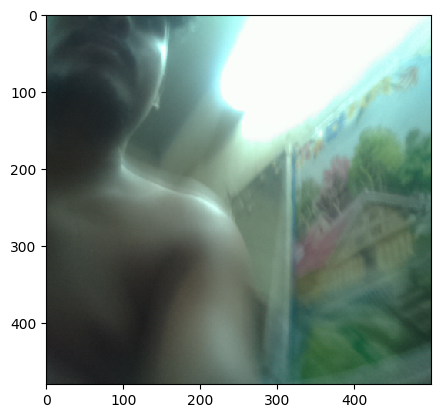

Image is 500x480
Image is verified


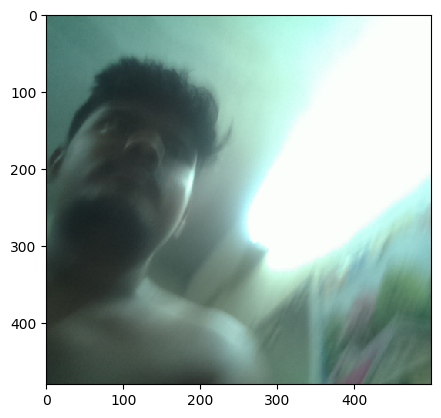

Image is 500x480
Image is verified


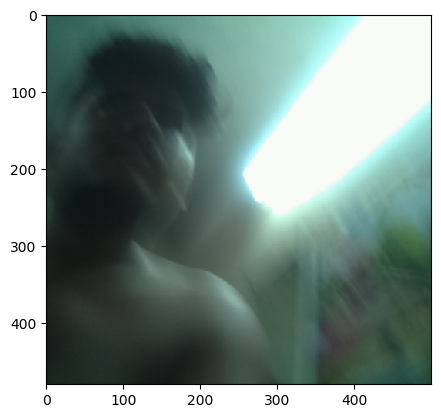

Image is 500x480
Image is verified


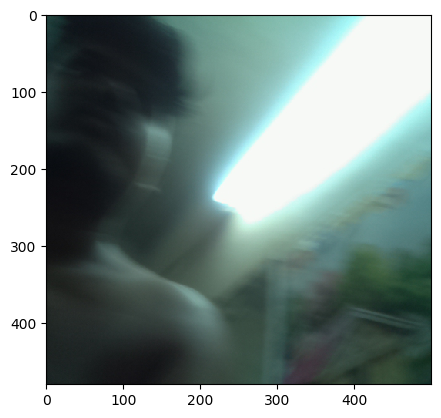

Image is 500x480
Image is verified


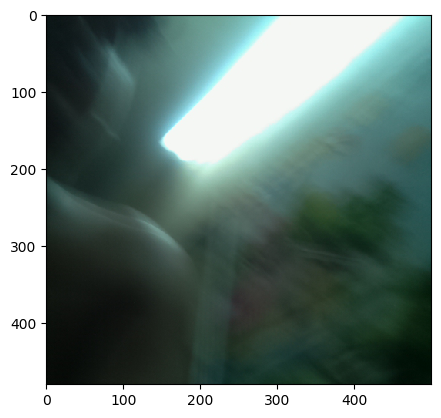

Image is 500x480
Image is verified


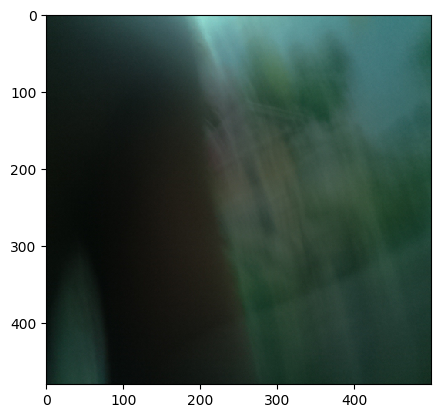

Image is 500x480
Image is verified


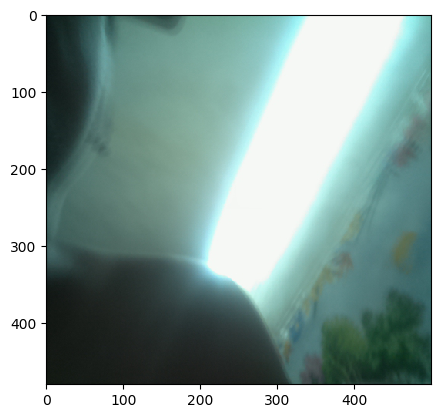

Image is 500x480
Image is verified


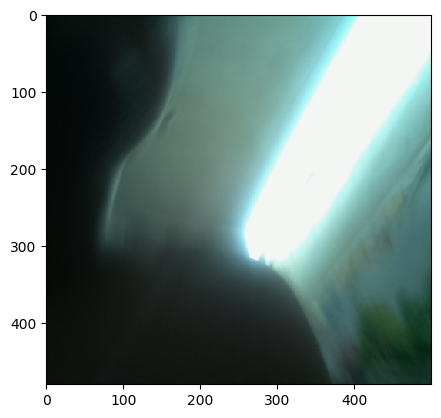

Image is 500x480
Image is verified


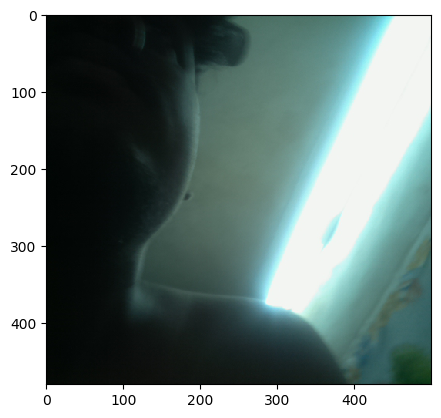

Image is 500x480
Image is verified


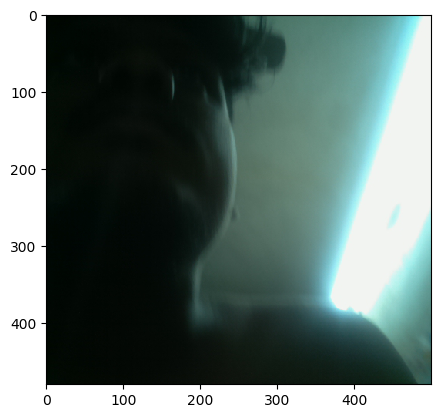

Image is 500x480
Image is verified


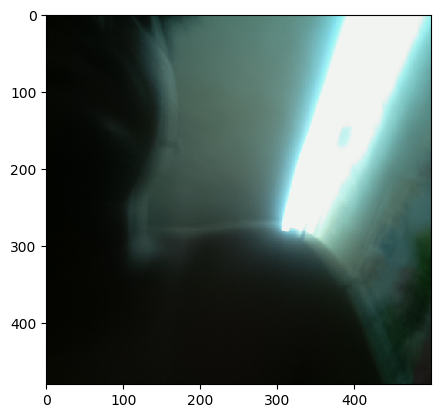

Image is 500x480
Image is verified


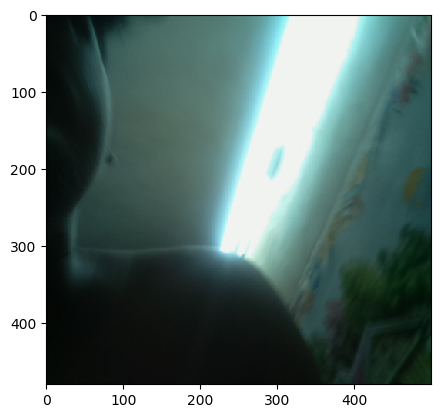

Image is 500x480
Image is verified


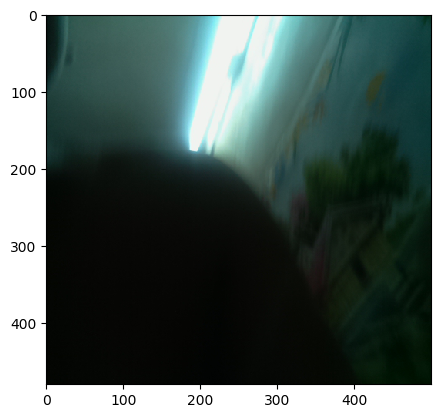

Image is 500x480
Image is verified


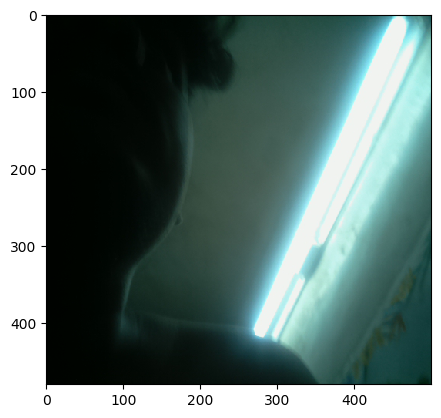

Image is 500x480
Image is verified


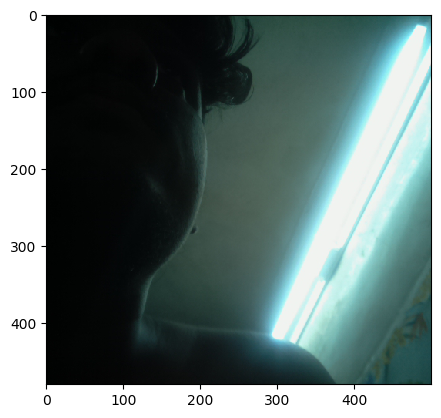

Image is 500x480
Image is verified


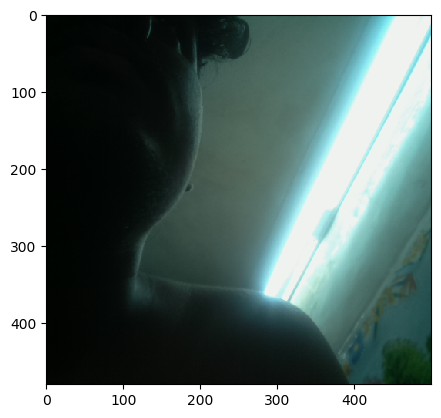

Image is 500x480
Image is verified


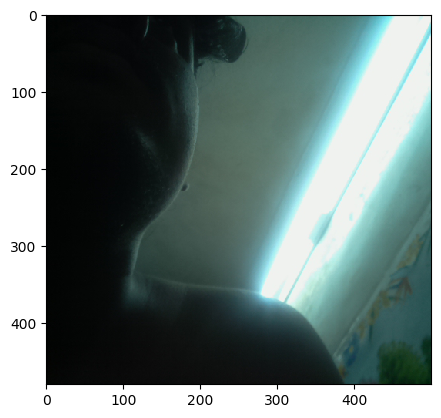

Image is 500x480
Image is verified


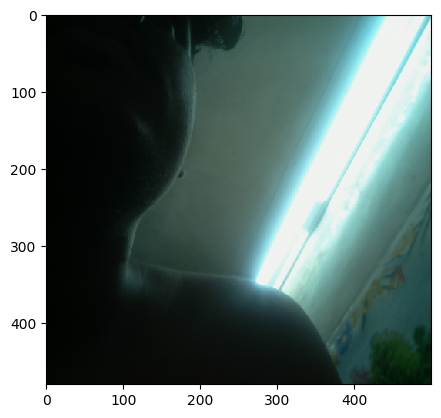

Image is 500x480
Image is verified


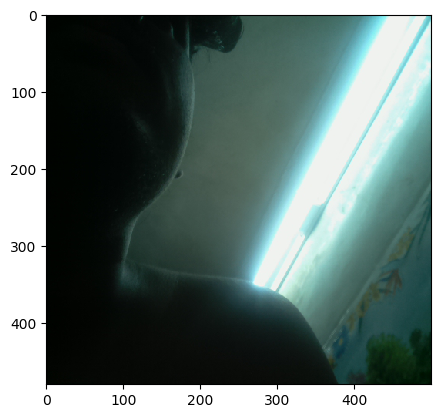

Image is 500x480
Image is verified


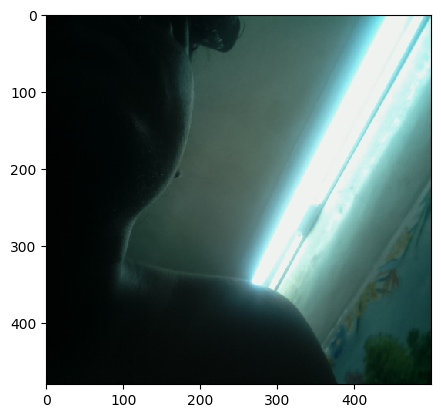

Image is 500x480
Image is verified


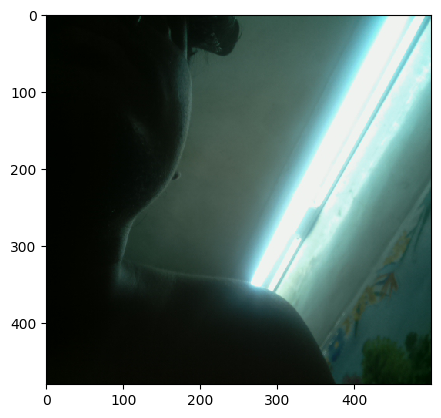

Image is 500x480
Image is verified


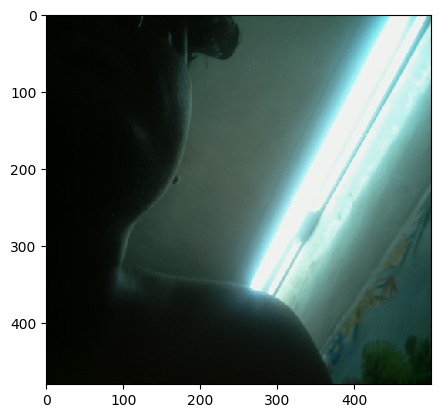

Image is 500x480
Image is verified


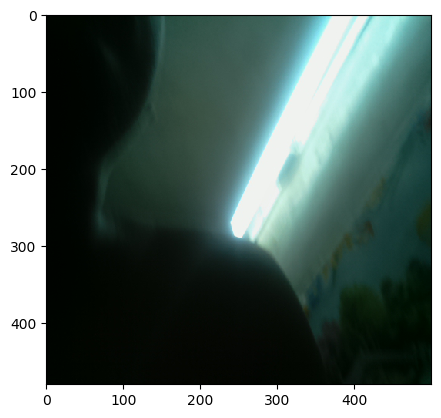

Image is 500x480
Image is verified


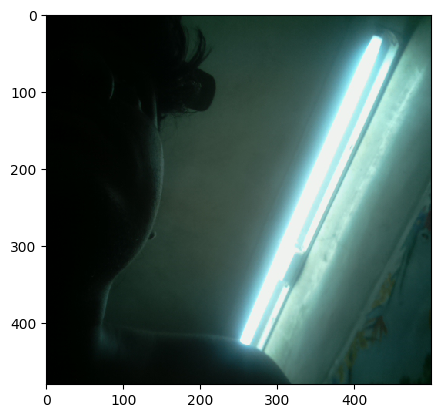

Image is 500x480
Image is verified


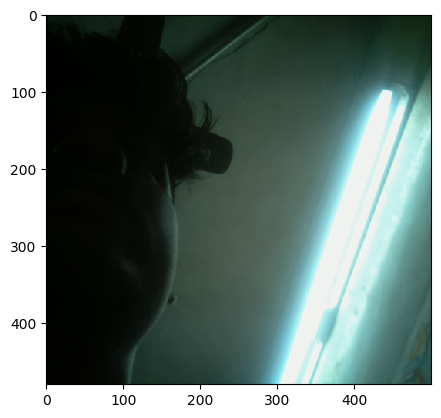

Image is 500x480
Image is verified


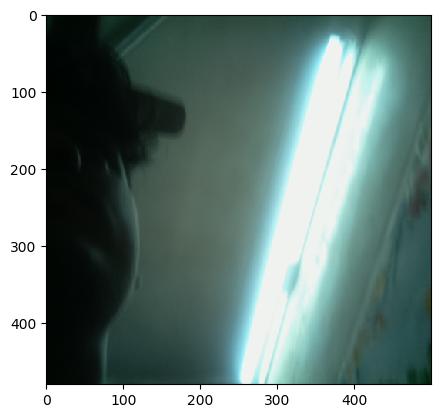

Image is 500x480
Image is verified


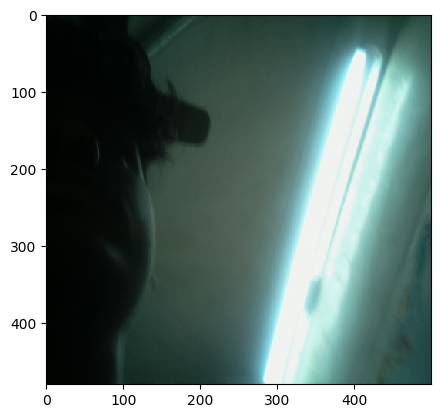

Image is 500x480
Image is verified


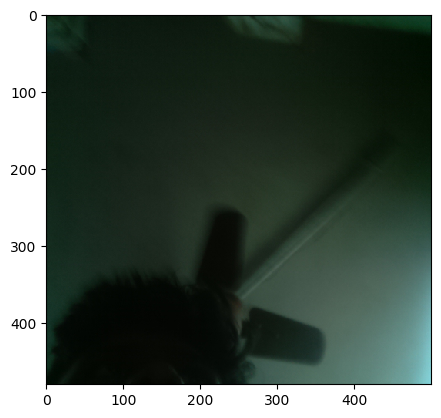

Image is 500x480
Image is verified


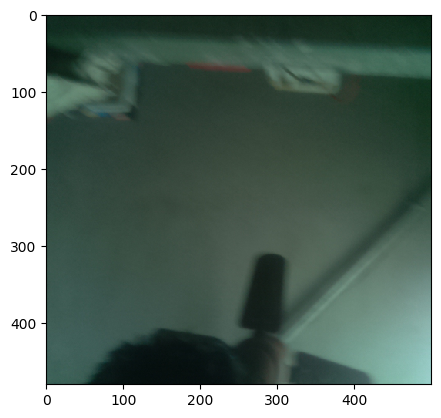

Image is 500x480
Image is verified


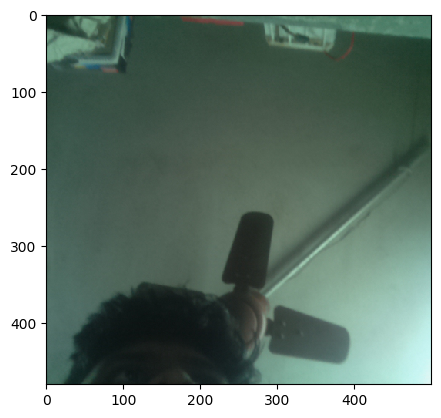

Image is 500x480
Image is verified


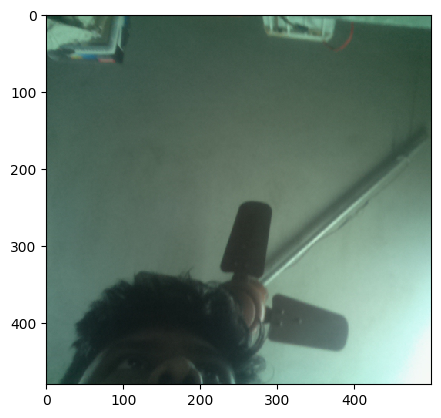

Image is 500x480
Image is verified


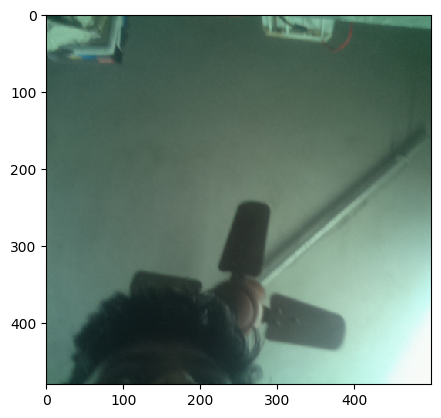

Image is 500x480
Image is verified


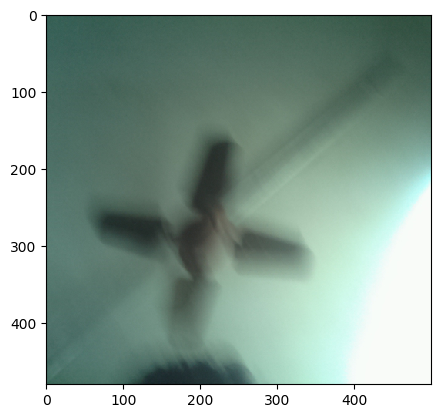

Image is 500x480
Image is verified


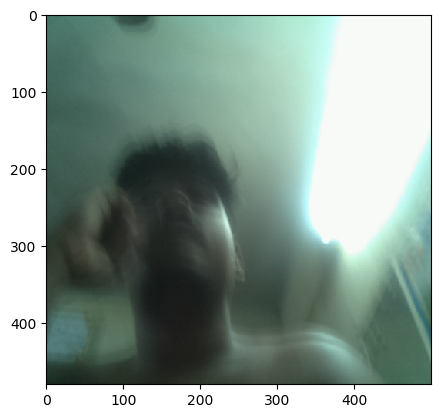

Image is 500x480
Image is verified


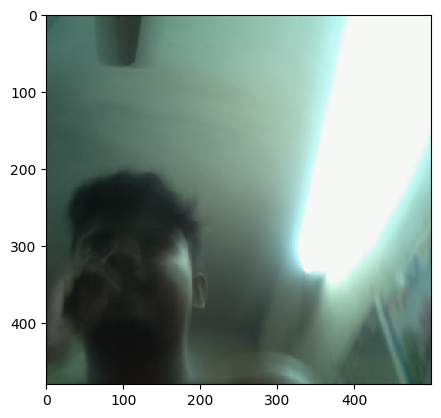

Image is 500x480
Image is verified


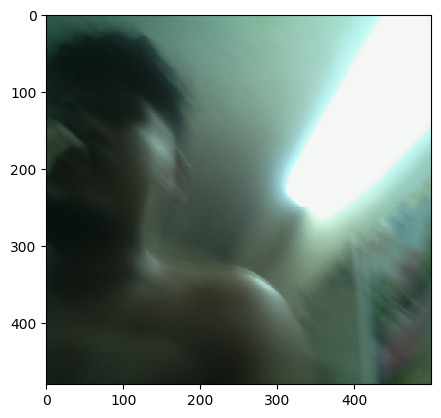

Image is 500x480
Image is verified


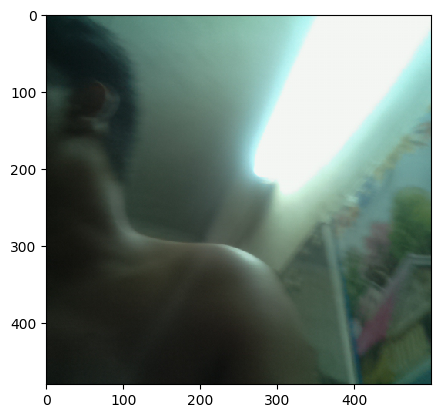

Image is 500x480
Image is verified


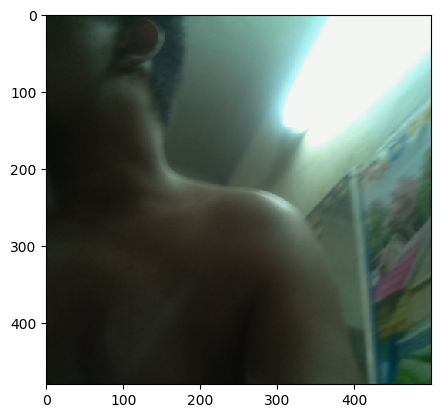

Image is 500x480
Image is verified


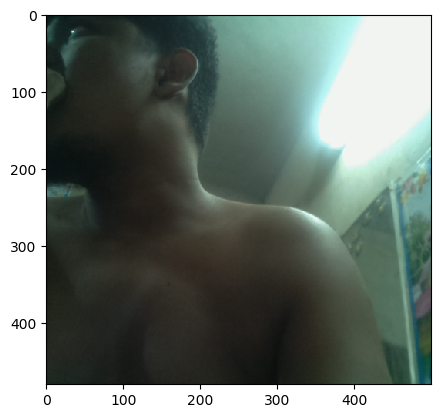

Image is 500x480
Image is verified


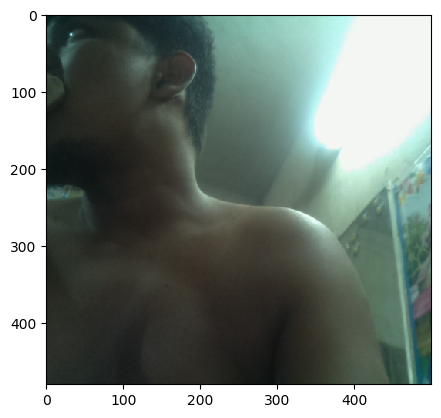

Image is 500x480
Image is verified


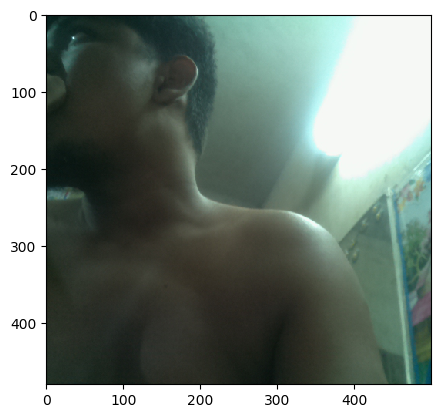

Image is 500x480
Image is verified


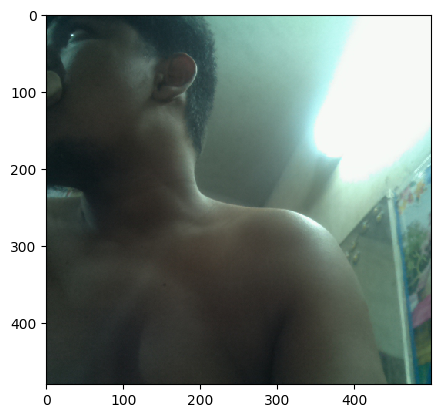

Image is 500x480
Image is verified


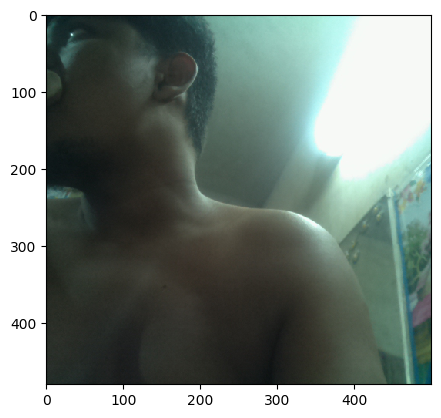

Image is 500x480
Image is verified


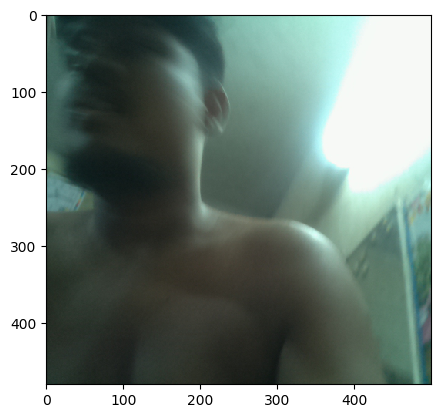

Image is 500x480
Image is verified


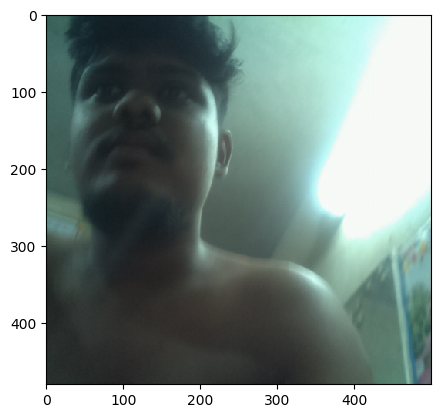

Image is 500x480
Image is verified


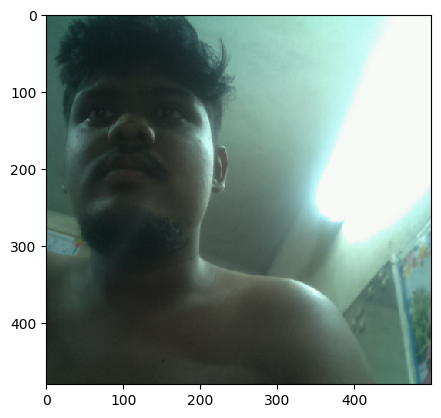

Image is 500x480
Image is verified


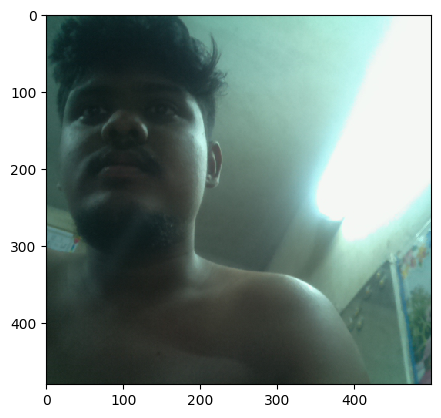

Image is 500x480
Image is verified


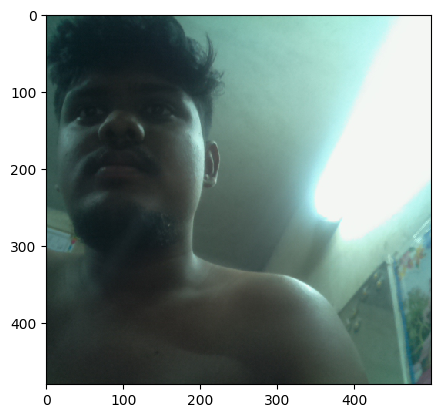

Image is 500x480
Image is verified


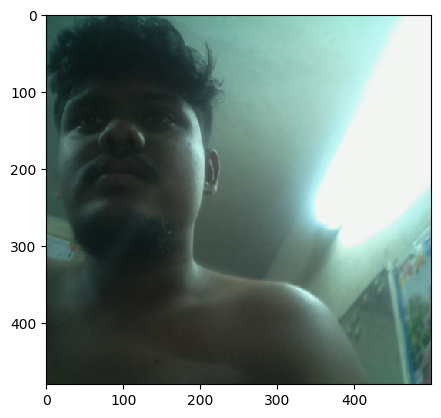

Image is 500x480
Image is verified


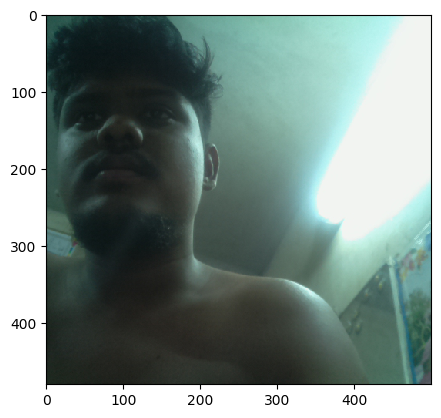

Image is 500x480
Image is verified


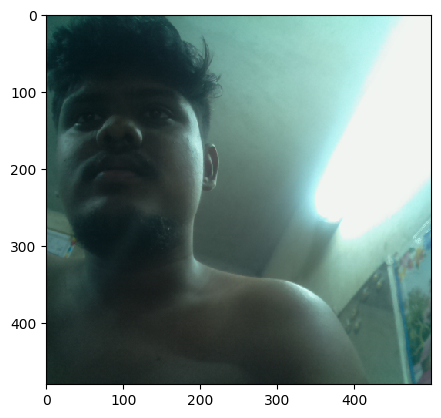

Image is 500x480
Image is verified


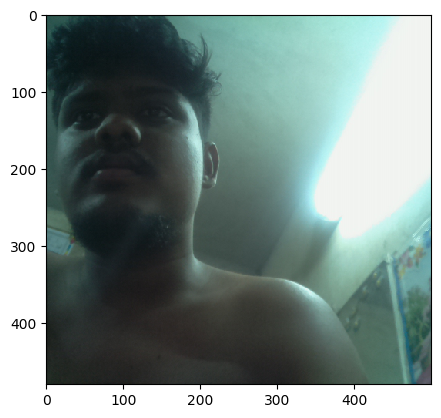

Image is 500x480
Image is verified


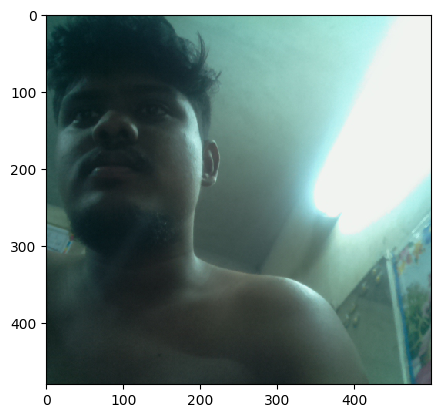

Image is 500x480
Image is verified


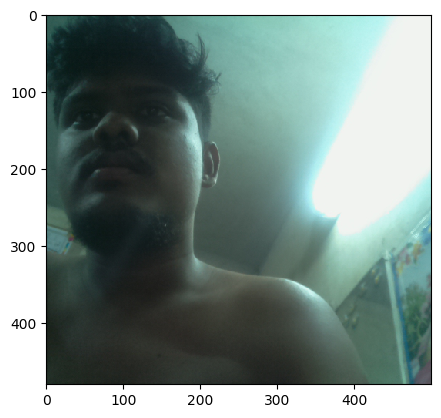

Image is 500x480
Image is verified


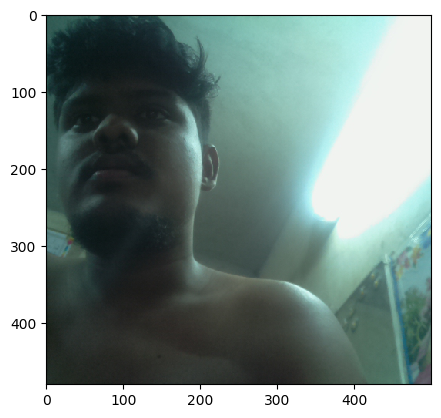

Image is 500x480
Image is verified


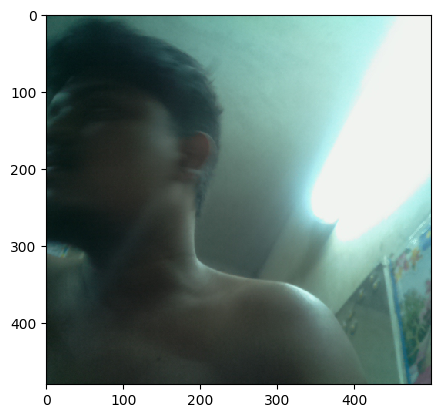

Image is 500x480
Image is verified


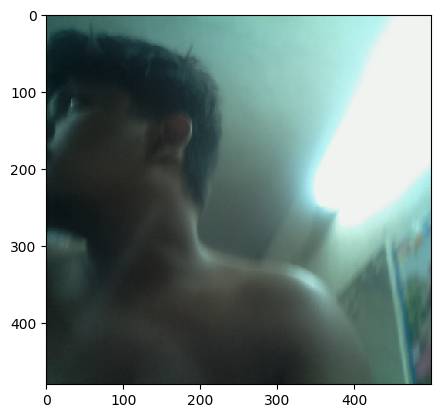

Image is 500x480
Image is verified


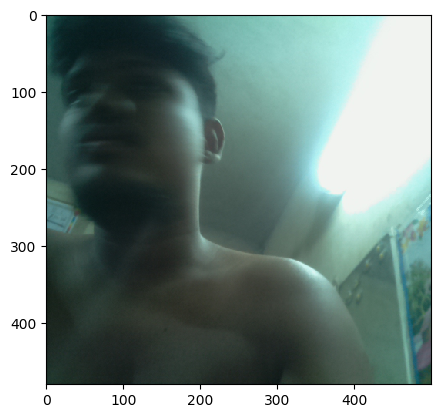

Image is 500x480
Image is verified


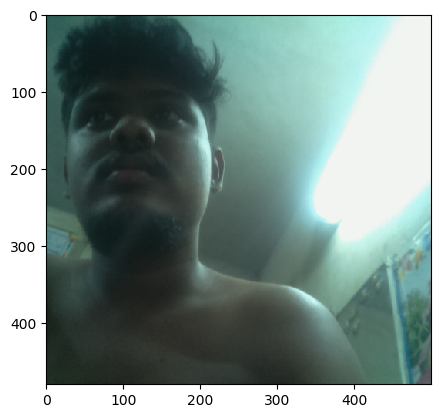

Image is 500x480
Image is verified


error: unpack requires a buffer of 4 bytes

In [8]:
import io
import socket
import struct
from PIL import Image
import matplotlib.pyplot as pl

server_socket = socket.socket()
server_socket.bind(('192.168.1.5', 8000))  # ADD IP HERE
server_socket.listen(0)

# Accept a single connection and make a file-like object out of it
connection = server_socket.accept()[0].makefile('rb')
try:
    img = None
    while True:
        # Read the length of the image as a 32-bit unsigned int. If the
        # length is zero, quit the loop
        image_len = struct.unpack('<L', connection.read(struct.calcsize('<L')))[0]
        if not image_len:
            break
        # Construct a stream to hold the image data and read the image
        # data from the connection
        image_stream = io.BytesIO()
        image_stream.write(connection.read(image_len))
        # Rewind the stream, open it as an image with PIL and do some
        # processing on it
        image_stream.seek(0)
        image = Image.open(image_stream)
        
        if img is None:
            img = pl.imshow(image)
        else:
            img=pl.imshow(image)
            img.set_data(image)

        pl.pause(0.001)
        pl.draw()

        print('Image is %dx%d' % image.size)
        image.verify()
        print('Image is verified')
finally:
    connection.close()
    server_socket.close()

In [11]:
import cv2
from facenet_pytorch.models.mtcnn import MTCNN
import numpy as np
import torch
import PIL as pl

In [12]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
mtcnn = MTCNN(keep_all=True, device=device)


def mtcnn_detect(img: np.ndarray) -> np.ndarray:
    boxes, probs = mtcnn.detect(img)
    for box in boxes:
        x_left = min(box[0], box[2])
        x_right = max(box[0], box[2])
        y_left = min(box[1], box[3])
        y_right = max(box[1], box[3])
        img = cv2.rectangle(img, (x_left, y_left), (x_right, y_right), 
                            (255, 0, 0), 2)

    return img

In [15]:
if __name__=='__main__':
    img=pl.Image.open('t1.jpg')
    image=mtcnn_detect(img)
    cv2.show(image)

error: OpenCV(4.5.3) :-1: error: (-5:Bad argument) in function 'rectangle'
> Overload resolution failed:
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'
>  - img is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'img'


In [1]:
from mtcnn import MTCNN
import cv2
import numpy as np
from keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing  import image

model = load_model (r"C:\Users\prince\Documents\mask prediction\mask_prediction.h5")
index=['masked','unmasked']
cap = cv2.VideoCapture(0)
detector = MTCNN()


while True:
    ret, frame = cap.read()

    if not ret: break
    frame = cv2.resize(frame, (640, 480))
        
        # Detect face
    img = frame.copy()
    result = detector.detect_faces(img)
    
        # Loop through list (if empty this will be skipped) and overlay green bboxes
        # Format of bboxes is: xmin, ymin (top left), xmax, ymax (bottom right)
    for face in result:
        xmin = face['box'][0]
        ymin = face['box'][1]
        xmax = xmin + face['box'][2]
        ymax = ymin + face['box'][3]
        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 255, 0), 3)
        roi= img[ymin:ymax, xmin:xmax]
        roi=cv2.resize(roi,(64,64))
        roi = roi.astype("float")/ 255.0
        roi = cv2.flip(roi,1,1)
        roi = image.img_to_array(roi)
        roi = np.expand_dims(roi, axis=0)
        label=index[np.argmax(model.predict(roi))]
        if label=="unmasked":
            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0, 0, 255), 3)
            cv2.putText(img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 2)
        cv2.putText( img, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 0, 255), 2)


    cv2.imshow("faces", img)
    k = cv2.waitKey(30) & 0xff
    if k == 27:
        break
 
cap.release()
cv2.destroyAllWindows()

Using TensorFlow backend.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
